# GBSV Minichallenge Griechenland
## Steckbrief
- Name: Griechenland
- Einwohner: 10.5 Mio
- Hauptstadt: Athen
- Fläche: 132.000 km²
- Währung: Euro
- Sprache: Griechisch
- Besonderheiten: Griechenland ist bekannt für seine antike Kultur und seine zahlreichen Inseln. Die Akropolis in Athen ist ein bekanntes Wahrzeichen.

## Bilderauswahl
### Akropolis
Die Akropolis ist ein antikes Bauwerk in Athen und ein bekanntes Wahrzeichen Griechenlands. Ich habe dieses Bild ausgewählt, da es viele Strukturen enthält, welche wichtig sind für LE2. 
![Akropolis](Akropolis.jpg)
Quelle: https://www.shutterstock.com/de/image-photo/parthenon-temple-on-sinset-acropolis-athens-591272060

### Santorin
Santorin ist eine Inselgruppe im Süden des Ägäischen Meeres. Die Inseln sind bekannt für ihre weißen Häuser und die blauen Dächer. Ich habe dieses Bild ausgewählt, da es die Farbenpracht der Inseln zeigt. Ich möchte im Rahmen des LE1 mit den Farben und Kontrasten dieses Bildes arbeiten.
![Santorin](santorini.jpg)
Quelle: https://www.viator.com/de-AT/tours/Santorini/Full-Day-Santorini-Highlights-and-Venetian-Castles-Small-Group-Tour/d959-72423P1

## Signalauswahl
### Nationalhymne Griechenlands
Die Nationalhymne Griechenlands ist das "Hymn to Liberty". Ich habe dieses Signal ausgewählt, da es einen bezug zu Griechenland hat und ich mit diesem Signal die Aufgaben der Signalverarbeitung bearbeiten kann.

In [ ]:
from IPython.display import Audio
from IPython.display import display

display(Audio('gr.mp3', autoplay=False))

## LE1
### 1.1 Bildeigenschaften Santorini

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Bild laden
img = cv2.imread('santorini.jpg')

# Bild anzeigen
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Santorini')

In [ ]:
img.shape

Das Bild hat eine Auflösung von 980 x 653 Pixeln und besteht aus 3 Farbkanälen (RGB).

In [ ]:
# Histogram
color = ('b', 'g', 'r')
for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(histr, color=col)
    plt.xlim([0, 256])
plt.legend(['Blue', 'Green', 'Red'])
plt.show()

In diesem Histogram ist zu erkennen, dass die Hauptfarbe des Bildes blau ist. Das ganze Bild hat einen Blaustich. Zusammen mit den Grünen Farbtönen ergibt es ebenfalls noch einen türkisen Farbton.
Ein Histogram eignet sich gut um die Farbverteilung in einem Bild zu analysieren.

#### Kontrastanpassung 

Ich habe zuerst die Kontrastanpassung im Windows-Fotoanzeiger durchgeführt damit ich eine Ground-Trouth erhalte.

In [ ]:
img = cv2.cvtColor(cv2.imread('santorini.jpg'), cv2.COLOR_BGR2RGB)
color = ('r', 'g', 'b')

fig, ax = plt.subplots(3, 2, figsize=(20, 15))
ax[0, 0].imshow(img)
ax[0, 0].set_title('Original')
ax[0, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    ax[0, 1].plot(histr, color=col)
    ax[0, 1].set_title('Original')
ax[0, 1].legend(['Red', 'Green', 'Blue'])


img_low_contrast = cv2.cvtColor(cv2.imread('santorini_kontrast_-100.jpg'), cv2.COLOR_BGR2RGB)

ax[1, 0].imshow(img_low_contrast)
ax[1, 0].set_title('Kontrastangepasst, -100%')
ax[1, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([img_low_contrast], [i], None, [256], [0, 256])
    ax[1, 1].plot(histr, color=col)
    ax[1, 1].set_title('Kontrastangepasst, -100%')
ax[1, 1].legend(['Red', 'Green', 'Blue'])


img_high_contrast = cv2.cvtColor(cv2.imread('santorini_kontrast_100.jpg'), cv2.COLOR_BGR2RGB)

ax[2, 0].imshow(img_high_contrast)
ax[2, 0].set_title('Kontrastangepasst, 100%')
ax[2, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([img_high_contrast], [i], None, [256], [0, 256])
    ax[2, 1].plot(histr, color=col)
    ax[2, 1].set_title('Kontrastangepasst, 100%')
ax[2, 1].legend(['Red', 'Green', 'Blue'])


plt.show()

An den Histogrammen ist zu erkennen, dass bei einer Kontrastanpassung von -100%, das Histogramm zusammengestaucht wird. Bei einer Kontrastanpassung von 100% wird das Histogramm auseinandergezogen. Beim Bild mit erhöhtem Kontrast hat es viele Werte bei 0 und 255. 

In [ ]:
img = cv2.imread('santorini.jpg')

def kontrastAnpassung(img, änderungsfaktor):
    durchschnitt = img.mean()
    neuesBild = np.clip(((img - durchschnitt) * änderungsfaktor) + durchschnitt, 0, 255).astype(np.uint8)
    return neuesBild

def contrast_with_openCV(img, factor):
    img_YUV = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    img_YUV[:, :, 0] = cv2.multiply(img_YUV[:, :, 0], np.array(factor))
    return cv2.cvtColor(img_YUV, cv2.COLOR_YUV2BGR)

# Bilder anzeigen
fig, ax = plt.subplots(4, 3, figsize=(20, 15))
ax[0, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 0].set_title('Original')
ax[0, 0].axis('off')

ax[0, 1].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 1].set_title('Original')
ax[0, 1].axis('off')

ax[0, 2].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 2].set_title('Original')
ax[0, 2].axis('off')

ax[1, 0].imshow(cv2.cvtColor(kontrastAnpassung(img, 0.5), cv2.COLOR_BGR2RGB))
ax[1, 0].set_title('Kontrastangepasst, Faktor 0.5')
ax[1, 0].axis('off')

ax[1, 1].imshow(cv2.cvtColor(contrast_with_openCV(img, 0.5), cv2.COLOR_BGR2RGB))
ax[1, 1].set_title('Kontrastangepasst OpenCV, Faktor 0.5')
ax[1, 1].axis('off')

img_low_contrast = cv2.cvtColor(cv2.imread('santorini_kontrast_-100.jpg'), cv2.COLOR_BGR2RGB)
ax[1, 2].imshow(img_low_contrast)
ax[1, 2].set_title('Kontrastangepasst Windows, -100%')
ax[1, 2].axis('off')

ax[2, 0].imshow(cv2.cvtColor(kontrastAnpassung(img, 1.5), cv2.COLOR_BGR2RGB))
ax[2, 0].set_title('Kontrastangepasst, Faktor 1.5')
ax[2, 0].axis('off')

ax[2, 1].imshow(cv2.cvtColor(contrast_with_openCV(img, 1.5), cv2.COLOR_BGR2RGB))
ax[2, 1].set_title('Kontrastangepasst OpenCV, Faktor 1.5')
ax[2, 1].axis('off')

img_high_contrast = cv2.cvtColor(cv2.imread('santorini_kontrast_100.jpg'), cv2.COLOR_BGR2RGB)
ax[2, 2].imshow(img_high_contrast)
ax[2, 2].set_title('Kontrastangepasst Windows, 100%')
ax[2, 2].axis('off')

ax[3, 0].imshow(cv2.cvtColor(kontrastAnpassung(img, 1.99), cv2.COLOR_BGR2RGB))
ax[3, 0].set_title('Kontrastangepasst, Faktor 2')
ax[3, 0].axis('off')

ax[3, 1].imshow(cv2.cvtColor(contrast_with_openCV(img, 1.99), cv2.COLOR_BGR2RGB))
ax[3, 1].set_title('Kontrastangepasst OpenCV, Faktor 2')
ax[3, 1].axis('off')

plt.show()

Nun möchte ich zwei Methoden zur Kontrastanpassung miteinander vergleichen. 
- Methode 1: Eigene Implementierung
    Ich habe zuerst den Durchschnittswert jeder Farbe abgezogen. Die Differenz habe ich mit dem gewünschten Änderungsfaktor multipliziert und den Durchschnittswert wieder hinzugefügt. Dabei können jedoch Werte über 255 oder unter 0 entstehen. Diese Werte habe ich mit der Funktion np.clip auf 0 oder 255 abgeschnitten.
- Methode 2: OpenCV Implementierung
    Ich habe die OpenCV Funktion cv2.cvtColor verwendet um das Bild in das YUV Farbmodell umzuwandeln. U und V stehen für die Farben und Y für die jeweilige Intensität. Deswegen habe ich den Y-Kanal mit dem gewünschten Faktor multipliziert. Anschließend habe ich das Bild wieder ins BGR Farbmodell zurückverwandelt.

Die Ergebnisse aus meiner Kontrastanpassung und dem von Windows-Fotoanzeiger sind sehr ähnlich. Die Implementierung mit OpenCV macht das Bild nur dunkler bzw. heller. Stärkerer Kontrast ist jedoch nicht zu erkennen.

In [ ]:
#Histogramm für alle Bilder
color = ('b', 'g', 'r')

fig, ax = plt.subplots(2, 2, figsize=(20, 15))
for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    ax[0, 0].plot(histr, color=col)
    ax[0, 0].set_title('Original')
ax[0, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 0.5)], [i], None, [256], [0, 256])
    ax[0, 1].plot(histr, color=col)
    ax[0, 1].set_title('Kontrastangepasst, 0.5')
ax[0, 1].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 1.5)], [i], None, [256], [0, 256])
    ax[1, 0].plot(histr, color=col)
    ax[1, 0].set_title('Kontrastangepasst, 1.5')
ax[1, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 2)], [i], None, [256], [0, 256])
    ax[1, 1].plot(histr, color=col)
    ax[1, 1].set_title('Kontrastangepasst, 2')
ax[1, 1].legend(['Blue', 'Green', 'Red'])
plt.show()

An den Histogrammen ist gut zu erkennen, dass die Farbspektren zusammengestaucht oder auseinandergezogen werden.
Bei einer Kontrastanpassung über 1 tritt der Posterisations-Effekt auf. Das bedeuted, dass die Verteilung der Farben auseinandergezogen werden und einige Farben nicht mehr vorkommen. Dadurch entstehen in den Histogrammen Zacken. Durch die np.clip Funktion werden die Werte auf 0 oder 255 abgeschnitten. Dadurch sind viele Werte entweder 0 oder 255.

#### Farbsättigung
Ich möchte nun mein Foto mit kräftigeren Farben darstellen. Dazu werde ich die Farbsättigung erhöhen.
Auch möchte ich ein Foto auf ein Aufgabenblatt drucken. Dazu möchte ich die Farbsättigung verringern bis es Schwarz/Weiss ist.

In [ ]:
def farbsättigung(img: np.ndarray, faktor: float) -> np.ndarray:
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype=np.float64)
    hsv[:, :, 1] = hsv[:, :, 1] * faktor
    hsv[:, :, 1] = np.clip(hsv[:, :, 1], 0, 255)
    img = cv2.cvtColor(np.array(hsv, dtype=np.uint8), cv2.COLOR_HSV2BGR)
    return img

Ich habe die Farbsättigung mit der OpenCV Funktion cv2.cvtColor durchgeführt. Dabei habe ich das Bild in das HSV Farbmodell umgewandelt. H steht für den Farbton, S für die Sättigung und V für die Helligkeit. Ich habe den S-Kanal mit dem gewünschten Faktor multipliziert. Anschließend habe ich das Bild wieder ins BGR Farbmodell zurückverwandelt.

In [ ]:
img = cv2.imread('santorini.jpg')

# Bilder anzeigen
fig, ax = plt.subplots(4, 2, figsize=(20, 20))
ax[0, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 0].set_title('Original')
ax[0, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    ax[0, 1].plot(histr, color=col)
    ax[0, 1].set_title('Original')
ax[0, 1].legend(['Blue', 'Green', 'Red'])

ax[1, 0].imshow(cv2.cvtColor(farbsättigung(img, 0), cv2.COLOR_BGR2RGB))
ax[1, 0].set_title('Farbsättigung, 0')
ax[1, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 0)], [i], None, [256], [0, 256])
    ax[1, 1].plot(histr, color=col)
    ax[1, 1].set_title('Farbsättigung, 0')
ax[1, 1].legend(['Blue', 'Green', 'Red'])

ax[2, 0].imshow(cv2.cvtColor(farbsättigung(img, 0.5), cv2.COLOR_BGR2RGB))
ax[2, 0].set_title('Farbsättigung, 0.5')
ax[2, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 0.5)], [i], None, [256], [0, 256])
    ax[2, 1].plot(histr, color=col)
    ax[2, 1].set_title('Farbsättigung, 0.5')
ax[2, 1].legend(['Blue', 'Green', 'Red'])

ax[3, 0].imshow(cv2.cvtColor(farbsättigung(img, 2), cv2.COLOR_BGR2RGB))
ax[3, 0].set_title('Farbsättigung, 2')
ax[3, 0].axis('off')

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 2)], [i], None, [256], [0, 256])
    ax[3, 1].plot(histr, color=col)
    ax[3, 1].set_title('Farbsättigung, 2')
ax[3, 1].legend(['Blue', 'Green', 'Red'])

plt.show()

Bei der Farbsättigung ist zu erkennen, dass die Farben kräftiger werden. Bei einer Farbsättigung von 0 wird das Bild Schwarz/Weiss. Das Histogramm zeigt, dass für jeden Pixel die Farbwerte gleich sind. Allgemein kann man sagen, dass bei einer Farbsättigung von unter 1 die Farbkanäle näher zusammengerückt werden und bei einer Farbsättigung von über 1 die Farbkanäle auseinandergezogen werden.

### 1.1 Bildeigenschaften Akropolis EVTL. entfernen

In [ ]:
# Bild laden
img = cv2.imread('Akropolis.jpg')

# Bild anzeigen
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Akropolis')
img.shape

In [ ]:
# Histogram
color = ('b', 'g', 'r')
for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(histr, color=col)
    plt.xlim([0, 256])
plt.legend(['Blue', 'Green', 'Red'])
plt.show()

#### Kontrastanpassung

In [ ]:
def kontrastAnpassung(img, änderungsfaktor):
    durchschnitt = img.mean()
    neuesBild = np.clip(((img - durchschnitt) * änderungsfaktor) + durchschnitt, 0, 255).astype(np.uint8)
    return neuesBild

In [ ]:
# Bilder anzeigen
fig, ax = plt.subplots(2, 2, figsize=(20, 15))
ax[0, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 0].set_title('Original')
ax[0, 0].axis('off')

ax[0, 1].imshow(cv2.cvtColor(kontrastAnpassung(img, 0.5), cv2.COLOR_BGR2RGB))
ax[0, 1].set_title('Kontrastangepasst, 0.5')
ax[0, 1].axis('off')

ax[1, 0].imshow(cv2.cvtColor(kontrastAnpassung(img, 1.5), cv2.COLOR_BGR2RGB))
ax[1, 0].set_title('Kontrastangepasst, 1.5')
ax[1, 0].axis('off')

ax[1, 1].imshow(cv2.cvtColor(kontrastAnpassung(img, 2), cv2.COLOR_BGR2RGB))
ax[1, 1].set_title('Kontrastangepasst, 2')
ax[1, 1].axis('off')

plt.show()

In [ ]:
plt.show()
#Histogramm für alle Bilder
color = ('b', 'g', 'r')

fig, ax = plt.subplots(2, 2, figsize=(20, 15))
for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    ax[0, 0].plot(histr, color=col)
    ax[0, 0].set_title('Original')
ax[0, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 0.5)], [i], None, [256], [0, 256])
    ax[0, 1].plot(histr, color=col)
    ax[0, 1].set_title('Kontrastangepasst, 0.5')
ax[0, 1].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 1.5)], [i], None, [256], [0, 256])
    ax[1, 0].plot(histr, color=col)
    ax[1, 0].set_title('Kontrastangepasst, 1.5')
ax[1, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([kontrastAnpassung(img, 2)], [i], None, [256], [0, 256])
    ax[1, 1].plot(histr, color=col)
    ax[1, 1].set_title('Kontrastangepasst, 2')
ax[1, 1].legend(['Blue', 'Green', 'Red'])
plt.show()

#### Farbsättigung

In [ ]:
# Bilder anzeigen
fig, ax = plt.subplots(2, 2, figsize=(20, 15))
ax[0, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax[0, 0].set_title('Original')
ax[0, 0].axis('off')

ax[0, 1].imshow(cv2.cvtColor(farbsättigung(img, 0.5), cv2.COLOR_BGR2RGB))
ax[0, 1].set_title('Farbsättigung, 0.5')
ax[0, 1].axis('off')

ax[1, 0].imshow(cv2.cvtColor(farbsättigung(img, 1.5), cv2.COLOR_BGR2RGB))
ax[1, 0].set_title('Farbsättigung, 1.5')
ax[1, 0].axis('off')

ax[1, 1].imshow(cv2.cvtColor(farbsättigung(img, 1.99), cv2.COLOR_BGR2RGB))
ax[1, 1].set_title('Farbsättigung, 2')
ax[1, 1].axis('off')

plt.show()

In [ ]:
# Histogramm für alle Bilder
color = ('b', 'g', 'r')

fig, ax = plt.subplots(2, 2, figsize=(20, 15))
for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0, 256])
    ax[0, 0].plot(histr, color=col)
    ax[0, 0].set_title('Original')
ax[0, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 0.5)], [i], None, [256], [0, 256])
    ax[0, 1].plot(histr, color=col)
    ax[0, 1].set_title('Farbsättigung, 0.5')
ax[0, 1].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 1.5)], [i], None, [256], [0, 256])
    ax[1, 0].plot(histr, color=col)
    ax[1, 0].set_title('Farbsättigung, 1.5')
ax[1, 0].legend(['Blue', 'Green', 'Red'])

for i, col in enumerate(color):
    histr = cv2.calcHist([farbsättigung(img, 1.99)], [i], None, [256], [0, 256])
    ax[1, 1].plot(histr, color=col)
    ax[1, 1].set_title('Farbsättigung, 2')
ax[1, 1].legend(['Blue', 'Green', 'Red'])

plt.show()

Beschreibung:

### 1.2 Signaleigeschaften



In [ ]:
# Import National Anthem
from IPython.display import Audio
from IPython.display import display

display(Audio('gr.mp3', autoplay=False))

Das Lied ist 45 Sekunden lang. Dafür habe ich eine Sampling Rate von 44100 Hz gewählt, da ich lieber eine zu hohe Sampling Rate wähle als eine zu niedrige.

In [ ]:
import librosa.display

y, sampleRate = librosa.load('gr.mp3', sr=44100)

t = np.arange(len(y)) / sampleRate

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t, y)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')

plt.show()

Die Wellenform zeigt die Amplitude des Signals über die Zeit. Die x-Achse zeigt die Zeit in Sekunden an und die y-Achse die Amplitude.
Es sind verschiedene Abschnitte in der Musik zu erkennen. Ebenfalls ist ein ruhigerer Abschnitt in der Mitte des Signals zu erkennen.

In [ ]:
y_sevenSeconds = y[:int(sampleRate * 7.3)]
t_sevenSeconds = t[:int(sampleRate * 7.3)]

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_sevenSeconds)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.show()

Um die Veränderungen besser zu erkennen, habe ich den Plot auf die ersten 7.3 Sekunden beschränkt. Das entspricht dem ersten Abschnitt des Liedes. 

#### Amplitudenmanipulation
##### Lautstärke erhöhen
Ich möchte nun die Musik lauter machen. Dazu werde ich die Amplitude des Signals erhöhen.

In [ ]:
y_sevenSecondsLauter = y_sevenSeconds * 3

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_sevenSecondsLauter)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.show()

Da nur die Werte mit drei multipliziert wurden, hat sich nur die y-Achse verändert. Die x-Achse bleibt gleich. Das Signal sollte nun lauter sein.

In [ ]:
display(Audio(y_sevenSecondsLauter, rate=sampleRate))

Leider ist das Signal nicht lauter geworden. Meine Vermutung ist der Audio-Player, welcher die Lautstärke reguliert.
##### Fade-In Effekt
Deswegen wollte ich nun einen Fade-In Effekt hinzufügen. Dazu werde ich die ersten 4 Sekunden des Signals langsam lauter machen.

In [ ]:
fade_in_effect = np.linspace(0, 1, int(4 * sampleRate))

y_fadeIn = np.copy(y_sevenSeconds)
y_fadeIn[:int(4 * sampleRate)] *= fade_in_effect

In [ ]:
# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_fadeIn)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.show()

Der Fade-In Effekt ist gut zu erkennen. Die Amplidute steigt langsam an.

In [ ]:
from IPython.display import Audio
from IPython.display import display

display(Audio(y_fadeIn, rate=sampleRate))

Nun kann man den Fade-In Effekt hören. Das Signal wird langsam lauter. 

#### Phasenmanipulation
##### Phasenumkehrung
Zuerst möchte ich die Phase des Signals umkehren um zu schauen ob es anderst klingt. Dazu werde ich die Amplitudenwerte mit -1 multiplizieren.

In [ ]:
import librosa.display
y, sampleRate = librosa.load('gr.mp3', sr=44100)
t = np.arange(len(y)) / sampleRate
y_sevenSeconds = y[:int(sampleRate * 7.3)]
t_sevenSeconds = t[:int(sampleRate * 7.3)]
y_sevenSecondsReversed = y_sevenSeconds * -1

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_sevenSecondsReversed)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.show()

Optisch ist nach der Phasenumkehrung keinen Unterschied zu erkennen.

In [ ]:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_sevenSecondsReversed, label='Inversed', alpha=0.3, c='blue')
plt.plot(t_sevenSeconds, y_sevenSeconds, label='Original', alpha=0.3, c='red')
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.xlim([1.1, 1.11])
plt.legend()
plt.show()

Betrachten wir jedoch einen kleinen Ausschnitt, so ist zu erkennen, dass die Amplitudenwerte genau das Gegenteil zum Original sind.

In [ ]:
display(Audio(y_sevenSecondsReversed, rate=sampleRate))

Akustisch ist der Unterschied jedoch nicht hörbar.

##### Vertikale Verschiebung
Nun möchte ich das Signal um 1.5 nach oben verschieben um zu schauen ob es einen Unterschied macht.

In [ ]:
y_sevenSecondsShifted = y_sevenSeconds + 1.5

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t_sevenSeconds, y_sevenSecondsShifted)
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.show()

Optisch ist nach der Verschiebung keinen Unterschied zu erkennen ausser das die y-Achse verschoben wurde.

In [ ]:
display(Audio(y_sevenSecondsShifted, rate=sampleRate))

Akustisch ist der Unterschied jedoch ebenfalls nicht hörbar. 

##### Analyse mit Fast Fourier Transformation (EVTL Unpassend hier)

In [264]:
import librosa.display
y, sampleRate = librosa.load('gr.mp3', sr=44100)
t = np.arange(len(y)) / sampleRate

y_fft = np.fft.fft(y)

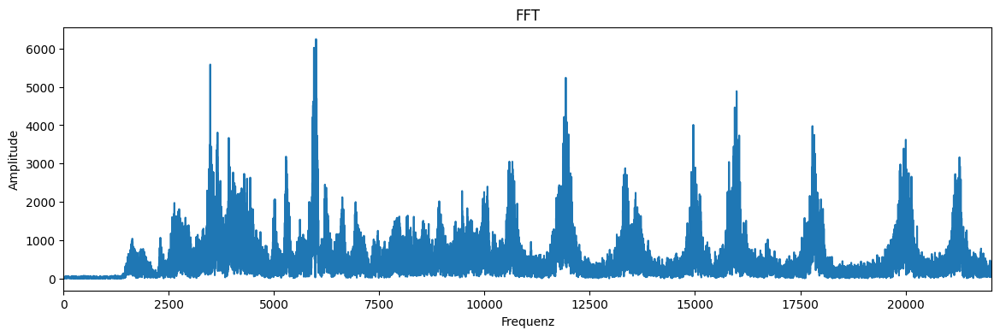

In [265]:
# Plot the FFT
plt.figure(figsize=(14, 4))
plt.plot(np.abs(y_fft))
plt.title('FFT')
plt.xlabel('Frequenz')
plt.ylabel('Amplitude')
plt.xlim([0, 22050])
plt.show()

Hier sind die Frequenzen abgebildet. Die y-Achse zeigt die Häufigkeit der Frequenzen an. Die x-Achse zeigt die Frequenzen an.

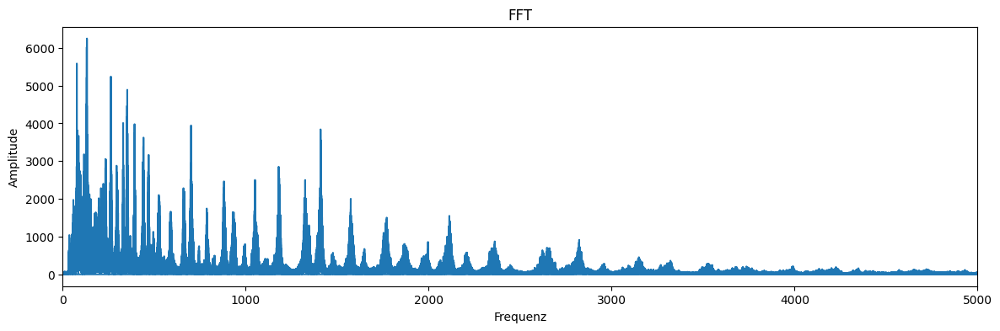

In [266]:
magnitude = np.abs(y_fft)
frequency = np.fft.fftfreq(len(magnitude), 1 / sampleRate)

# Plot the FFT
plt.figure(figsize=(14, 4))
plt.plot(frequency, magnitude)
plt.title('FFT')
plt.xlabel('Frequenz')
plt.ylabel('Amplitude')
plt.xlim([0, 5000])
plt.show()

Hier sind die verschiedenen Frequenzen abgebildet. Die Spitzen zeigen an welche Frequenzen am lautesten sind. 

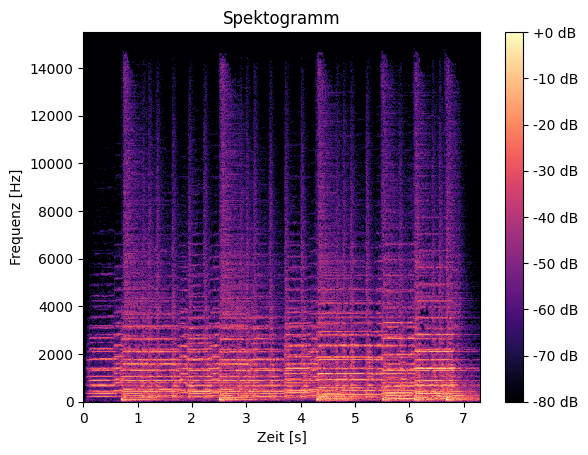

In [267]:
# Spektogramm
import librosa.display

stft = librosa.stft(y)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)
librosa.display.specshow(decibel, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.ylim([0, 15500])
plt.xlim([0, 7.3])
plt.show()


In [268]:
def rekonstruiere_wichtige_frequenzen_signal(original, anzahl_frequenzen):
    fft = np.fft.fft(original)
    magnitude = np.abs(fft)
    top_indices = np.argsort(magnitude)[-anzahl_frequenzen:]
    fft_filtered = np.zeros_like(fft)
    for index in top_indices:
        fft_filtered[index] = fft[index]
        if index != 0:
            fft_filtered[-index] = fft[-index]
    y_filtered = np.fft.ifft(fft_filtered)
    y_filtered_real = np.real(y_filtered)
    return y_filtered_real

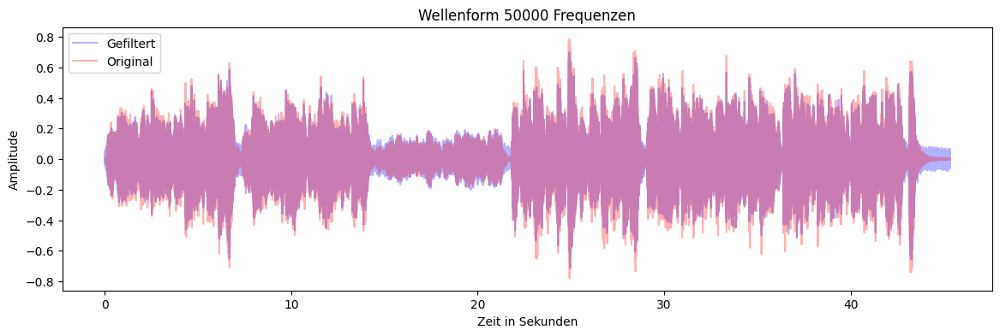

In [269]:
# Plot the filtered signal:
rekonstruierte_Frequenzen = 50000
plt.figure(figsize=(14, 4))
plt.plot(t, rekonstruiere_wichtige_frequenzen_signal(y, rekonstruierte_Frequenzen), c='blue', label='Gefiltert',
         alpha=0.3)
plt.plot(t, y, c='red', label='Original', alpha=0.3)
plt.title(f'Wellenform {rekonstruierte_Frequenzen} Frequenzen')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.legend()
#plt.xlim([1.1,1.2])
plt.show()

In [270]:
display(Audio(rekonstruiere_wichtige_frequenzen_signal(y, rekonstruierte_Frequenzen), rate=sampleRate))

Nun berechnen wir den Rekonsruktionsfehler für verschiedene Anzahlen von Frequenzen.

In [271]:
def rekonstruiere_frequenzen_bis_signal(original, maximaleFrequenz):
    fft = np.fft.fft(original)
    
    frequencies = np.fft.fftfreq(len(fft), 1 / sampleRate)
    
    filter = np.abs(frequencies) < maximaleFrequenz
    fft_filtered = fft * filter
    
    y_filtered = np.fft.ifft(fft_filtered)
    y_filtered_real = np.real(y_filtered)
    return y_filtered_real

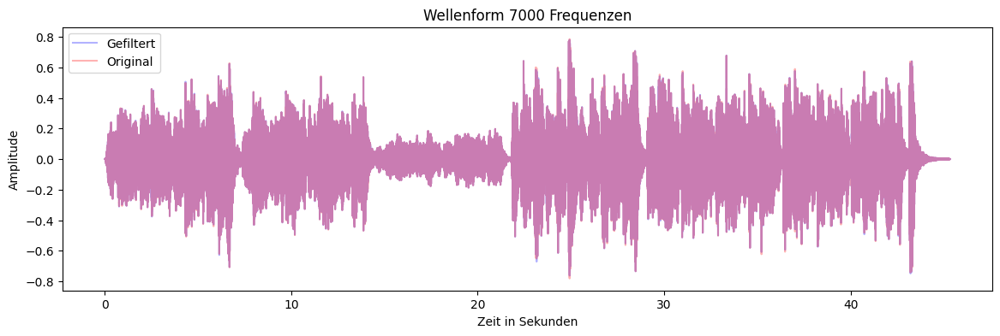

In [272]:
import librosa.display
y, sampleRate = librosa.load('gr.mp3', sr=44100)
t = np.arange(len(y)) / sampleRate

# Plot the filtered signal:
rekonstruierte_Frequenzen = 7000
plt.figure(figsize=(14, 4))
plt.plot(t, rekonstruiere_frequenzen_bis_signal(y, rekonstruierte_Frequenzen), c='blue', label='Gefiltert',
         alpha=0.3)
plt.plot(t, y, c='red', label='Original', alpha=0.3)
plt.title(f'Wellenform {rekonstruierte_Frequenzen} Frequenzen')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.legend()
#plt.xlim([1.1,1.2])
plt.show()

In [273]:
def rekonstruiere_frequenzen_bis_signal(original, maximaleFrequenz):
    fft = np.fft.fft(original)
    
    frequencies = np.fft.fftfreq(len(fft), 1 / sampleRate)
    
    filter = np.abs(frequencies) > maximaleFrequenz
    fft_filtered = fft * filter
    
    y_filtered = np.fft.ifft(fft_filtered)
    y_filtered_real = np.real(y_filtered)
    return y_filtered_real

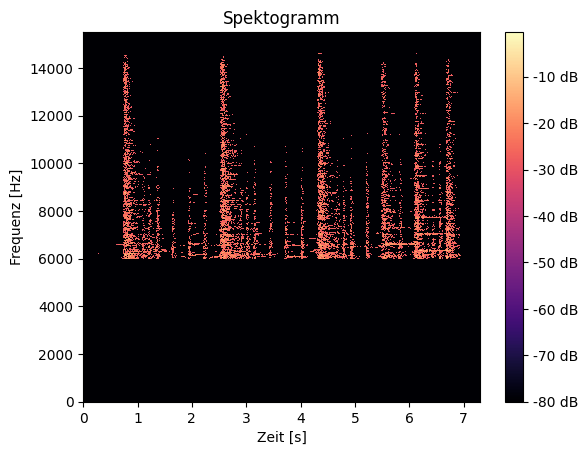

In [274]:
rekonstruierte_Frequenzen = 6000
rekonstruiertes_Signal = rekonstruiere_frequenzen_bis_signal(y, rekonstruierte_Frequenzen)

# Spektogramm
import librosa.display

stft = librosa.stft(rekonstruiertes_Signal)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

dbfilter_maske = decibel > -30

decibel_filtered = decibel * dbfilter_maske
decibel_filtered = np.where(decibel_filtered == 0, -80, decibel_filtered)


librosa.display.specshow(decibel_filtered, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.ylim([0, 15500])
plt.xlim([0, 7.3])
plt.show()

In [275]:
y_decibel_filtered = librosa.istft(decibel_filtered)

display(Audio(y_decibel_filtered, rate=sampleRate))

In [276]:
print(f'Shape y: {y.shape}')
print(f'Shape y_decibel_filtered: {y_decibel_filtered.shape}')

# Fill the rest with zeros:
y_decibel_filtered = np.pad(y_decibel_filtered, (0, len(y) - len(y_decibel_filtered)), 'constant')

print(f'Shape y: {y.shape}')
print(f'Shape y_decibel_filtered: {y_decibel_filtered.shape}')

Shape y: (1998720,)
Shape y_decibel_filtered: (1998336,)
Shape y: (1998720,)
Shape y_decibel_filtered: (1998720,)


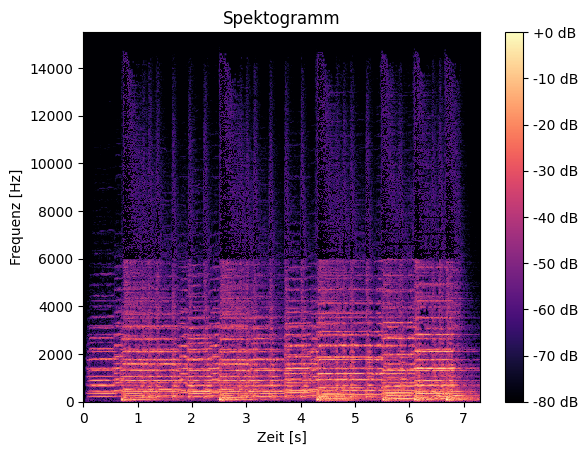

In [277]:
# Remove all sound form y_decibel_filtered in the original signal
#y_decibel_filtered_filter = np.where(y_decibel_filtered > -70, y, -80)

stft = librosa.stft(y)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

sound_gefiltert = np.where(decibel_filtered <= -79, decibel, -80)

librosa.display.specshow(sound_gefiltert, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.ylim([0, 15500])
plt.xlim([0, 7.3])
plt.show()


In [278]:
y_decibel_filtered.max()

1.0033590521237055

In [279]:
test = librosa.istft(sound_gefiltert)

test_real = np.real(test)

display(Audio(test_real, rate=sampleRate))

In [280]:
display(Audio(rekonstruiere_frequenzen_bis_signal(y, rekonstruierte_Frequenzen), rate=sampleRate))

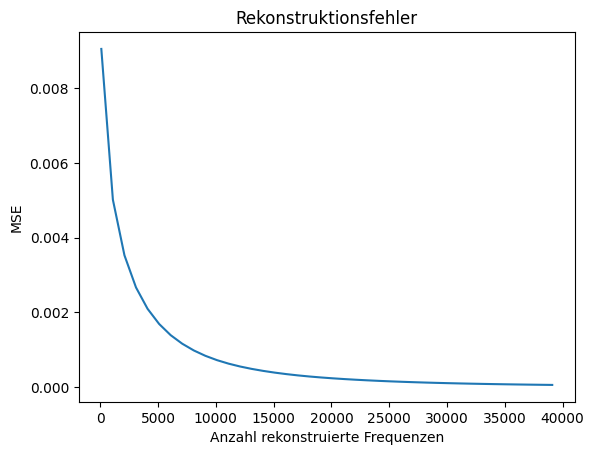

In [281]:
def mse(original, rekonstruiert):
    return np.mean((original - rekonstruiert) ** 2)


frequncies = np.arange(100, 40000, 1000)
errors = [mse(y_sevenSeconds, rekonstruiere_wichtige_frequenzen_signal(y_sevenSeconds, f)) for f in frequncies]

# Plot the error:
plt.plot(frequncies, errors)
plt.title('Rekonstruktionsfehler')
plt.xlabel('Anzahl rekonstruierte Frequenzen')
plt.ylabel('MSE')
plt.show()

MSE erklären

### Nyqist Theorem
#### Grenzwertanalyse
Um das Nyquist Theorem zu zeigen, müssen wir die Grenzwerte der Sampling Rate untersuchen. Dazu werde ich die Fast Fourier Transformation durchführen und die Frequenzen analysieren.

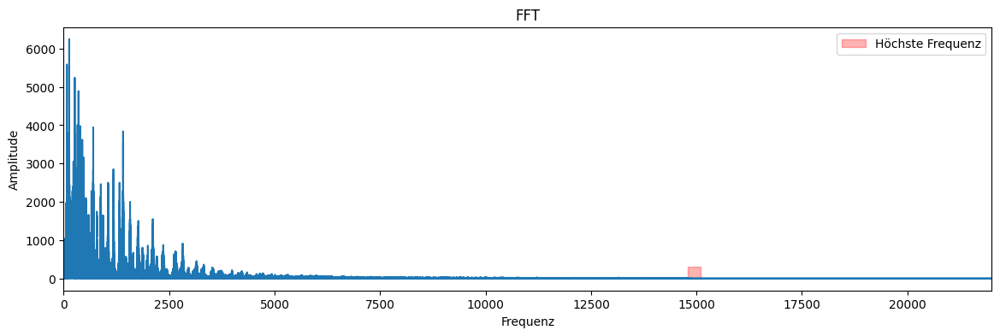

In [399]:
import librosa.display
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

y, sampleRate = librosa.load('gr.mp3', sr=44100)
t = np.arange(len(y)) / sampleRate

y_fft = np.fft.fft(y)
magnitude = np.abs(y_fft)
frequency = np.fft.fftfreq(len(magnitude), 1 / sampleRate)

plt.figure(figsize=(14, 4))
plt.plot(frequency, magnitude)
plt.title('FFT')
plt.xlabel('Frequenz')
plt.ylabel('Amplitude')
plt.xlim([0, 22000])
plt.gca().add_patch(patches.Rectangle((14800, 0), 300, 300, alpha=0.3, color='red', label='Höchste Frequenz'))
plt.legend()
plt.show()

Die höchste vorkommende Frequenz liegt bei 15 Kiloherz. Das Nyquist Theorem besagt, dass die Sampling Rate mindestens doppelt so hoch sein muss wie die höchste vorkommende Frequenz. Das bedeutet, dass die Sampling Rate mindestens 30 Kiloherz betragen muss. 
Die ungewöhnlich hohe Sampling Rate ist vermutlich auf das Hi-Hat (Schlagzeug) im Musikstück zurückzuführen.

In [334]:
def mse(original, rekonstruiert):
    if len(original) > len(rekonstruiert):
        original = original[:len(rekonstruiert)]
    else:
        rekonstruiert = rekonstruiert[:len(original)]
    return np.mean((original - rekonstruiert) ** 2)

100%|██████████| 89/89 [00:09<00:00,  9.09it/s]


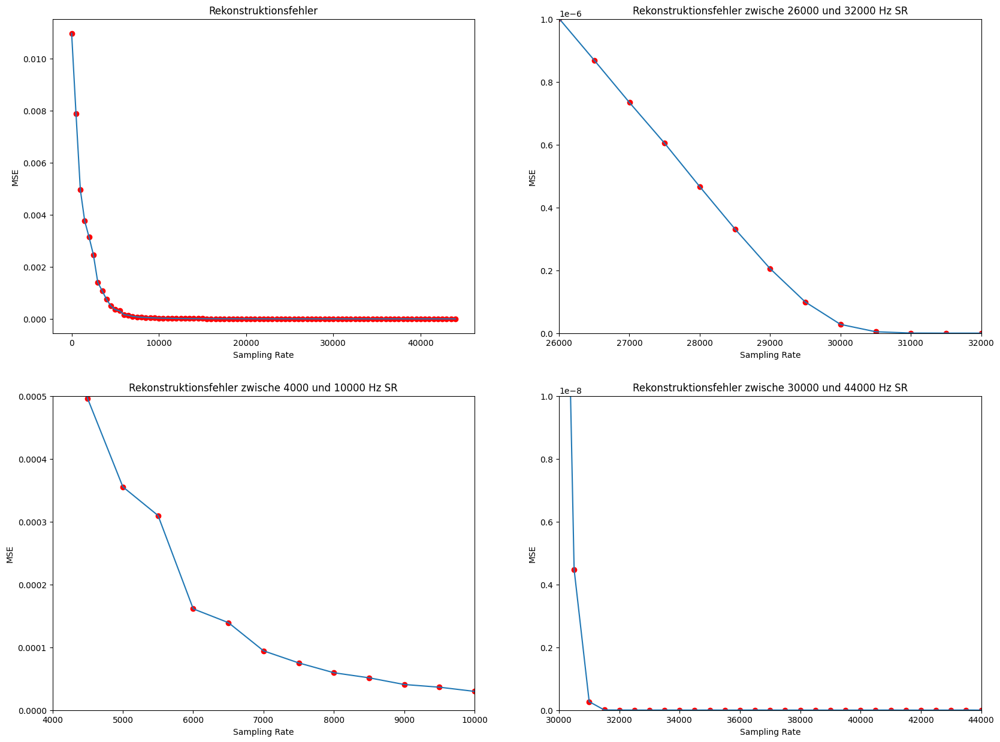

In [401]:
from tqdm import tqdm

sampling_rates = np.arange(1, 44100, 500)
original, sr_original = librosa.load('gr.mp3', sr=44100)
errors = []
for sr in tqdm(sampling_rates):
    y_resampled, sr = librosa.load('gr.mp3', sr=sr)
    y_resampled = librosa.resample(y_resampled, orig_sr=sr, target_sr=44100)
    
    errors.append(mse(original, y_resampled))

fig, ax = plt.subplots(2, 2, figsize=(20, 15))
ax[0,0].plot(sampling_rates, errors)
ax[0,0].scatter(sampling_rates, errors, color='red')
ax[0,0].set_title(f'Rekonstruktionsfehler')
ax[0,0].set_xlabel('Sampling Rate')
ax[0,0].set_ylabel('MSE')

ax[0,1].plot(sampling_rates, errors)
ax[0,1].scatter(sampling_rates, errors, color='red')
ax[0,1].set_ylim([0, 0.000001])
ax[0,1].set_xlim([26000, 32000])
ax[0,1].set_title(f'Rekonstruktionsfehler zwische 26000 und 32000 Hz SR')
ax[0,1].set_xlabel('Sampling Rate')
ax[0,1].set_ylabel('MSE')

ax[1,0].plot(sampling_rates, errors)
ax[1,0].scatter(sampling_rates, errors, color='red')
ax[1,0].set_ylim([0, 0.0005])
ax[1,0].set_xlim([4000, 10000])
ax[1,0].set_title(f'Rekonstruktionsfehler zwische 4000 und 10000 Hz SR')
ax[1,0].set_xlabel('Sampling Rate')
ax[1,0].set_ylabel('MSE')


ax[1,1].plot(sampling_rates, errors)
ax[1,1].scatter(sampling_rates, errors, color='red')
ax[1,1].set_ylim([0, 0.00000001])
ax[1,1].set_xlim([30000, 44000])
ax[1,1].set_title(f'Rekonstruktionsfehler zwische 30000 und 44000 Hz SR')
ax[1,1].set_xlabel('Sampling Rate')
ax[1,1].set_ylabel('MSE')

plt.show()

Hier habe ich den Rekonstruktionsfehler für verschiedene Sampling Rates berechnet. Die Graphen zeigen Ausschnitte und Vergrösserungen des ursprünglichen Graphen.
- Auf dem ersten Grafik ist der gesamte Graph zu sehen. Er ist bei einer Sampling Rate von 10 kHz bereits sehr tief. Spielt man nun das Musikstück ab, so ist der Unterschied sehr gut hörbar. Somit ist die Sampling Rate von 10 kHz zu tief.
- Der zweite Graph zeigt den Bereich zwischen 26 kHz und 32 kHz. Hier ist zu erkennen, dass der Rekonstruktionsfehler bei einer Sampling Rate von 31 kHz am auf Null fällt. Bestätigen können wir dies, indem wir das Musikstück abspielen. Es ist kein Unterschied zum Original zu hören.
- Der dritte Graph zeigt den Bereich zwischen 4 kHz und 10 kHz. Gut zu erkennen ist, dass mit steigender Sampling Rate der Rekonstruktionsfehler sinkt.
- Der vierte Graph zeigt den Bereich zwischen 30 kHz und 44 kHz. Zusätzlich zum zweiten Graph wollte ich zeigen, dass der Rekonstruktionsfehler bei Null bleibt.

##### 10kHz Sampling Rate (Sehr Tief)

In [411]:
import librosa.display

ziel_sr = 10000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
display(Audio(y, rate=sampleRate))


In diesem Audio ist das Downsampling gut zu hören. Das Musikstück klingt sehr tief und dumpf.

##### 31kHz Sampling Rate (Optimal)

In [412]:

ziel_sr = 31000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
display(Audio(y, rate=sampleRate))


In diesem Audio ist kein Unterschied zum Original zu hören. Das Musikstück klingt gleich.

##### 26kHz Sampling Rate (Tief)

In [413]:

ziel_sr = 26000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
display(Audio(y, rate=sampleRate))

In diesem Audio ist das Downsampling fast nicht zu hören. Wenn man sich jedoch auf die hohen Hi-Hat-Schläge konzentriert, so ist ein leichter Unterschied zum Original zu hören.

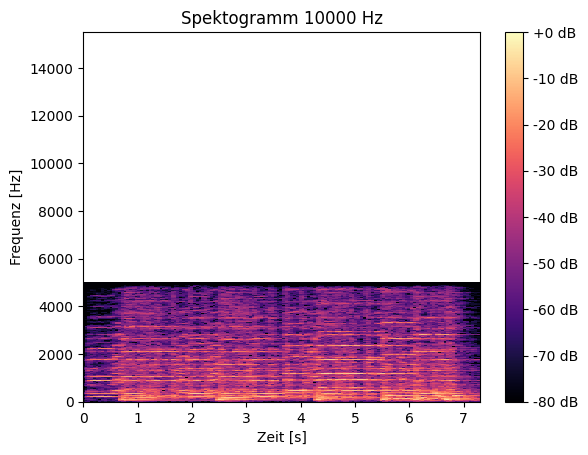

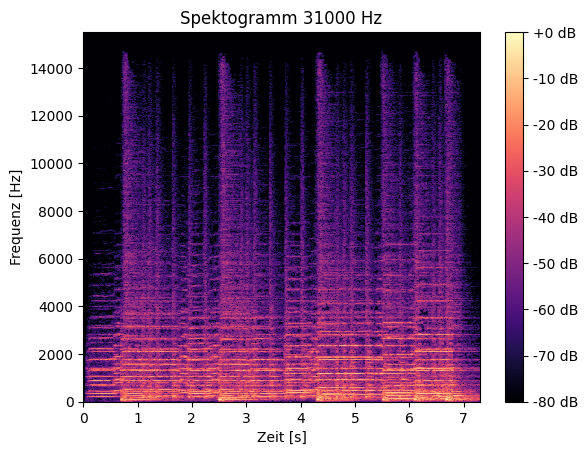

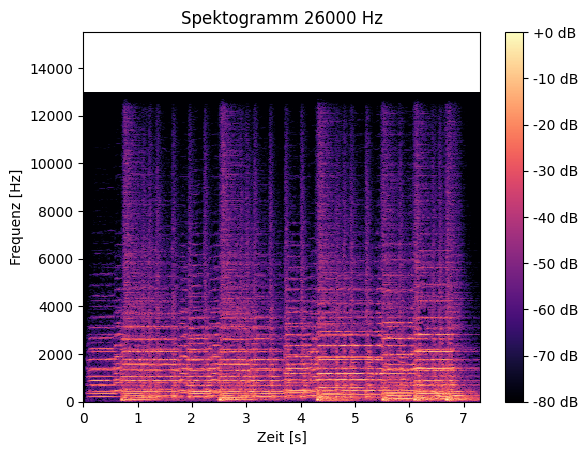

In [415]:
ziel_sr = 10000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
stft = librosa.stft(y)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

librosa.display.specshow(decibel, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm 10000 Hz')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.xlim([0, 7.3])
plt.ylim([0, 15500])
plt.show()

ziel_sr = 31000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
stft = librosa.stft(y)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

librosa.display.specshow(decibel, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm 31000 Hz')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.xlim([0, 7.3])
plt.ylim([0, 15500])
plt.show()

ziel_sr = 26000
y, sampleRate = librosa.load('gr.mp3', sr=ziel_sr)
stft = librosa.stft(y)
decibel = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

librosa.display.specshow(decibel, sr=sampleRate, x_axis='time', y_axis='hz')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektogramm 26000 Hz')
plt.ylabel('Frequenz [Hz]')
plt.xlabel('Zeit [s]')
plt.xlim([0, 7.3])
plt.ylim([0, 15500])
plt.show()

Da die Audios sehr ähnlich klingen, habe ich die Spektogramme verglichen.
- Das Spektogramm mit 10 kHz zeigt, dass die hohen Frequenzen fehlen. Die höchste Frequenz ist bei 5 kHz.
- Das Spektogramm mit 31 kHz zeigt alle Frequenzen.
- Im Spektogramm mit 26 kHz sind die starken Ausprägungen nach oben, breitet als bei dem mit 31 kHz. Ebenfalls sind nur Frequenzen bis 13 kHz zu erkennen.


C:\Program Files\Python311\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


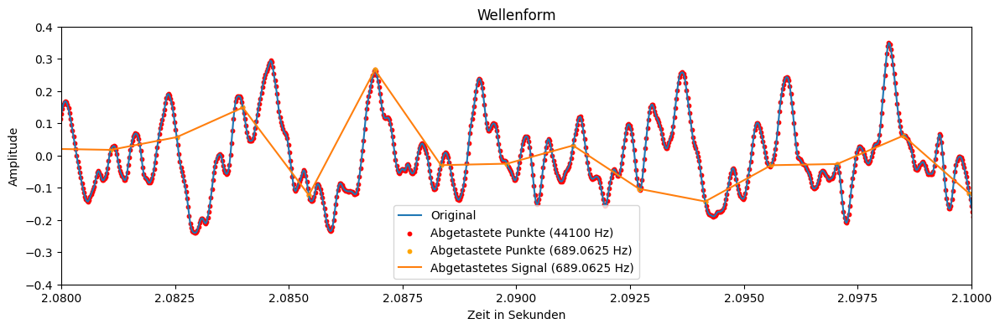

In [284]:
import librosa.display
import soundfile as sf

y, sampleRate = librosa.load('gr.mp3', sr=44100)

jederNteAbtastwert = 64
sampleRate_low = sampleRate/jederNteAbtastwert
y_low = y[::jederNteAbtastwert]
t = np.arange(len(y)) / sampleRate
t_low = np.arange(len(y_low)) / sampleRate_low

sf.write('gr_low.wav', y_low, int(sampleRate_low))

# Plot the signal:
plt.figure(figsize=(14, 4))
plt.plot(t, y, label='Original')
plt.scatter(t, y, color='red', s=10, label=f'Abgetastete Punkte ({sampleRate} Hz)')
plt.scatter(t_low, y_low, color='orange', s=10, label=f'Abgetastete Punkte ({sampleRate_low} Hz)')
plt.plot(t_low, y_low, label=f'Abgetastetes Signal ({sampleRate_low} Hz)')
plt.title('Wellenform')
plt.xlabel('Zeit in Sekunden')
plt.ylabel('Amplitude')
plt.xlim(2.08, 2.10)
plt.ylim(-0.4, 0.4)
plt.legend()
plt.show()

Hier ist ein Abschnitt aus dem Musikstück zu sehen. Die roten Punkte zeigen die Abtastwerte des Originals. Die orangen Punkte zeigen die Abtastwerte des abgetasteten Signals. Das abgetastete Signal ist in Orange dargestellt.
Um den Effekt besser zu Visualisieren, habe ich eine sehr tiefe Sampling Rate von 689 Hz gewählt.

In [417]:
# play gr_low.wav
from IPython.display import Audio
from IPython.display import display

y, sampleRate = librosa.load('gr_low.wav', sr=44100)
display(Audio(y, rate=sampleRate))

Der Vollständigkeit halber ist hier das Audio mit der sehr tiefen Sampling Rate von 689Hz. Das ursprüngliche Musikstück ist jedoch kaum mehr zu erkennen.

## LE2
### Filterung in der räumlichen Domäne
#### Weichzeichnen
##### Ganzes Bild Weichzeichnen

(702, 1000, 3)

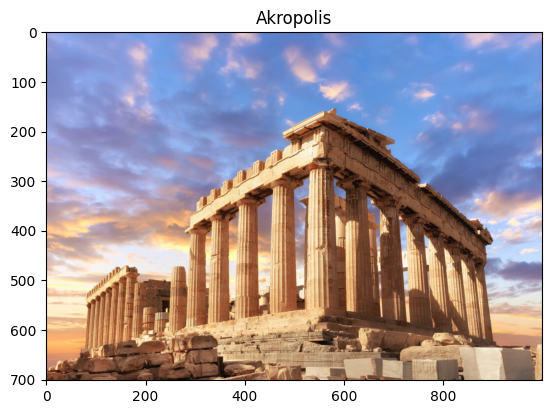

In [418]:
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2RGB)
# Bild anzeigen
plt.imshow(img)
plt.title('Akropolis')
img.shape

In [419]:
def weichzeichner_library(img: np.ndarray, kernel_size: int, sigma: int) -> np.ndarray:
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), sigma)

In [420]:
def gaussian_kernel(kernel_size: int, sigma: float) -> np.ndarray:
    size = int(kernel_size) // 2
    x, y = np.mgrid[-size:size+1, -size:size+1]
    normal = 1 / (2.0 * np.pi * sigma ** 2)
    g = np.exp(-(x ** 2 + y ** 2) / (2 * sigma ** 2)) * normal
    return g / g.sum()

In [421]:
def weichzeichner_eigener_filter(img: np.ndarray, kernel_size: int, sigma: int) -> np.ndarray:
    image_height, image_width, image_color = img.shape
    edge = kernel_size // 2

    padded_img = np.pad(img, ((edge, edge), (edge, edge), (0, 0)), mode='constant')
    blurred_img = np.zeros_like(img)
    kernel = gaussian_kernel(kernel_size, sigma)

    for i in range(image_height):
        for j in range(image_width):
            for k in range(image_color):
                blurred_img[i, j, k] = np.sum(padded_img[i:i + kernel_size, j:j + kernel_size, k] * kernel)

    return blurred_img

(702, 1000, 3)

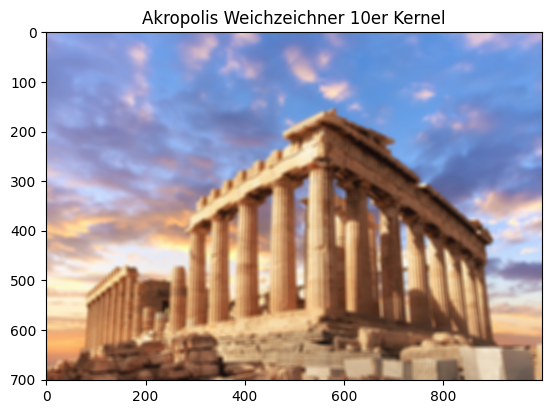

In [422]:
plt.imshow(weichzeichner_library(img, 9, 9))
plt.title(f'Akropolis Weichzeichner {9}er Kernel')
img.shape

Hier ist das Bild mit einem 9x9 Kernel weichgezeichnet. Ich habe dazu die OpenCV Library verwendet.

(702, 1000, 3)

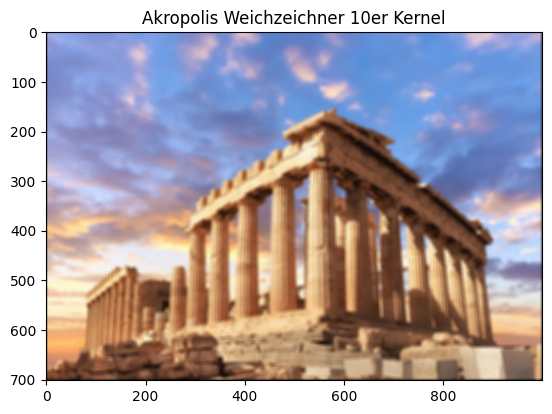

In [423]:
neuesBild = weichzeichner_eigener_filter(img, 9, 9)
plt.imshow(neuesBild)
plt.title(f'Akropolis Weichzeichner {10}er Kernel')
img.shape

In [424]:
neuesBild.shape

(702, 1000, 3)

In [425]:
unterschied = weichzeichner_library(img, 9, 9) - weichzeichner_eigener_filter(img, 9, 9)
print(f'Mittelwert: {unterschied.mean()}')

Mittelwert: 1.3079078822412156


Text(0.5, 1.0, 'Unterschied')

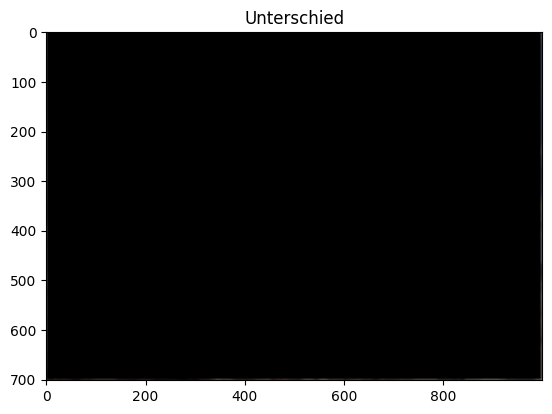

In [426]:
plt.imshow(unterschied)
plt.title('Unterschied')

##### Kleiner Bereich Weichzeichnen

Text(0.5, 1.0, 'Ausschnitt')

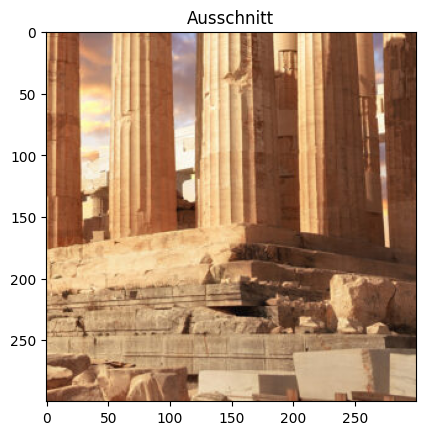

In [427]:
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2RGB)

bildbereich = img[400:700, 400:700]
plt.imshow(bildbereich)
plt.title('Ausschnitt')

Text(0.5, 1.0, 'Ausschnitt Weichzeichner')

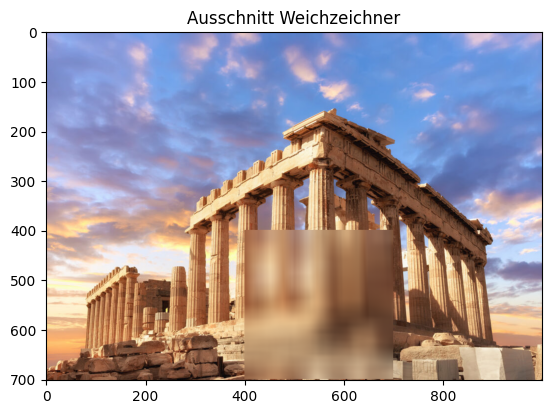

In [428]:
weichgezeichneterAusschnitt = weichzeichner_library(bildbereich, 51, 500)
img[400:700, 400:700] = weichgezeichneterAusschnitt
plt.imshow(img)
plt.title('Ausschnitt Weichzeichner')

##### Messmethoden

SSIM: 0.7399279870584342


Text(0.5, 1.0, 'Differenzbild (SSIM: 0.7399279870584342)')

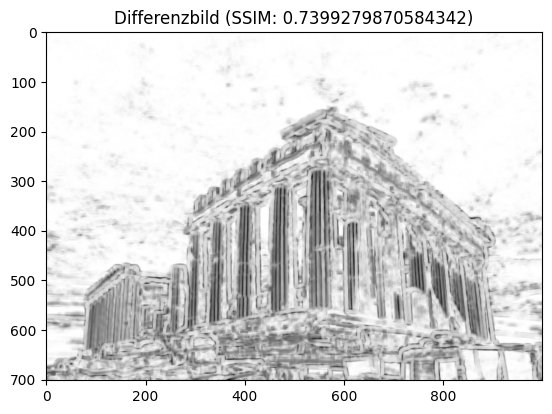

In [429]:
# SSIM
import skimage.metrics

# Ganzes Bild weichzeichnen
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)

(ssim, diff) = skimage.metrics.structural_similarity(img, weichzeichner_library(img, 9, 9), full=True)
print(f'SSIM: {ssim}')

plt.imshow(diff, cmap='gray')
plt.title(f'Differenzbild (SSIM: {ssim})')

Text(0.5, 1.0, 'Differenzbild (SSIM: 0.9093294648238293)')

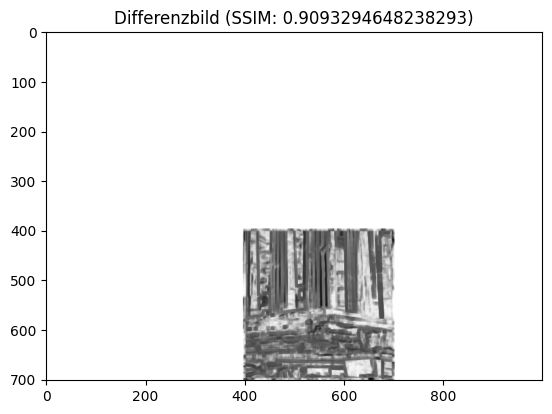

In [430]:
# Ausschnitt weichzeichnen
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)
imgWeichgezeichnet = img.copy()
bildbereich = img[400:700, 400:700]
weichgezeichneterAusschnitt = weichzeichner_library(bildbereich, 51, 500)

imgWeichgezeichnet[400:700, 400:700] = weichgezeichneterAusschnitt

(ssim, diff) = skimage.metrics.structural_similarity(img, imgWeichgezeichnet, full=True)
plt.imshow(diff, cmap='gray')
plt.title(f'Differenzbild (SSIM: {ssim})')

Text(0.5, 1.0, 'Differenzbild (SSIM: 0.3458588958496344)')

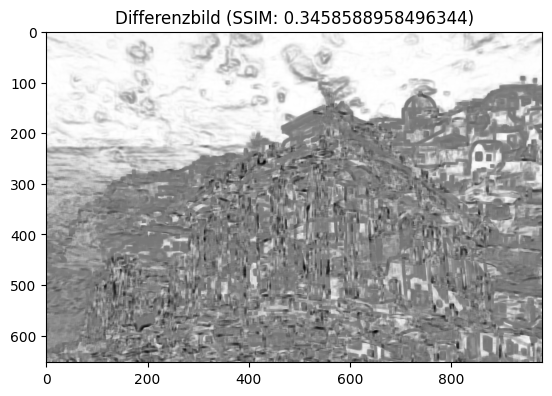

In [431]:

# Anderes Bild vergleichen

img = cv2.cvtColor(cv2.imread('santorini.jpg'), cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)

# Gleiche grösse
img2 = cv2.resize(img2, (img.shape[1], img.shape[0]))

(ssim, diff) = skimage.metrics.structural_similarity(img, img2, full=True)
plt.imshow(diff, cmap='gray')
plt.title(f'Differenzbild (SSIM: {ssim})')

#### Schärfen

In [432]:
def sharpen_img(img: np.ndarray, sigma: int, strength: int):
    # Blur the image
    blurred_image = weichzeichner_library(img, 0, sigma)
    
    # Apply the unsharp mask
    sharpened_image = cv2.addWeighted(img, 1 + strength, blurred_image, -strength, 0)
    
    return sharpened_image

Text(0.5, 1.0, 'Geschärftes Bild')

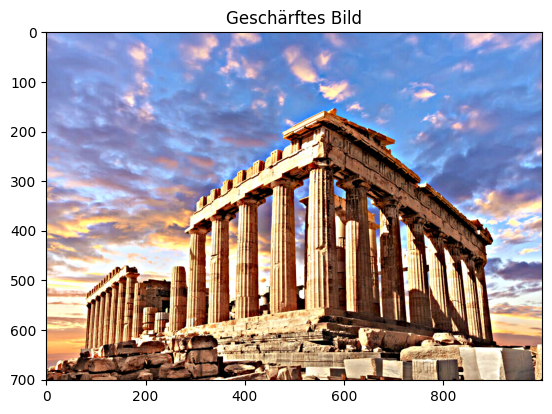

In [433]:
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2RGB)

sharp_img = sharpen_img(img, 9, 1.5)

plt.imshow(sharp_img)
plt.title('Geschärftes Bild')

SSIM: 0.8013043430138886


Text(0.5, 1.0, 'Differenzbild (SSIM: 0.8013043430138886)')

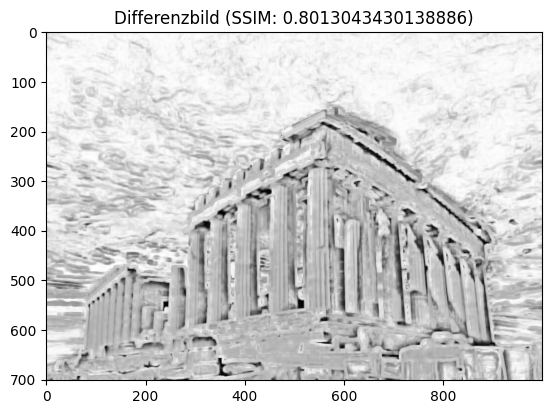

In [434]:
# SSIM
import skimage.metrics

# Ganzes Bild weichzeichnen
img = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)
sharp_img_gray = cv2.cvtColor(sharp_img, cv2.COLOR_BGR2GRAY)

(ssim, diff) = skimage.metrics.structural_similarity(img, sharp_img_gray, full=True)
print(f'SSIM: {ssim}')

plt.imshow(diff, cmap='gray')
plt.title(f'Differenzbild (SSIM: {ssim})')

Schärfen Santorini

Text(0.5, 1.0, 'Geschärftes Bild')

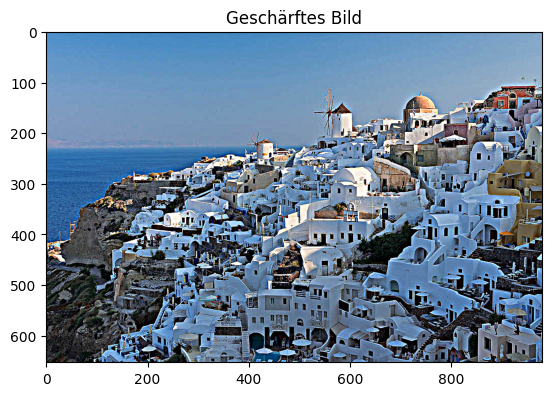

In [435]:
img_santorini = cv2.cvtColor(cv2.imread('santorini.jpg'), cv2.COLOR_BGR2RGB)

sharp_img_santorini = sharpen_img(img_santorini, 5, 1.5)

plt.imshow(sharp_img_santorini)
plt.title('Geschärftes Bild')

Text(0.5, 1.0, 'Differenzbild (SSIM: 0.8202170168196703)')

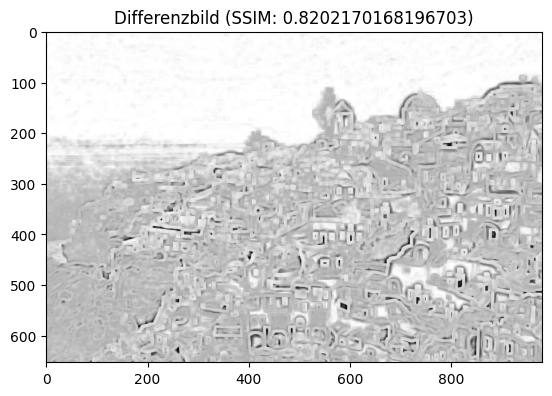

In [436]:
# SSIM
img_santorini_gray = cv2.cvtColor(img_santorini, cv2.COLOR_BGR2GRAY)

sharp_img_santorini_gray = cv2.cvtColor(sharp_img_santorini, cv2.COLOR_BGR2GRAY)

(ssim, diff) = skimage.metrics.structural_similarity(img_santorini_gray, sharp_img_santorini_gray, full=True)

plt.imshow(diff, cmap='gray')
plt.title(f'Differenzbild (SSIM: {ssim})')

### Filterung in der Frequenzdomäne
#### Fourier auf vertikale Linien

In [437]:
def dreiBilderFourier(img: np.ndarray, img2: np.ndarray, img3: np.ndarray, ssim: float, mae: float):
    fig, ax = plt.subplots(1, 3, figsize=(20, 15))
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title(f'Differenz zu Originalbild SSIM={ssim}, mae={mae}')
    ax[0].axis('off')

    ax[1].imshow(img2, cmap='gray')
    ax[1].set_title('Fourier Transformation')
    ax[1].axis('off')

    ax[2].imshow(img3, cmap='gray')
    ax[2].set_title('Rücktransformation')
    ax[2].axis('off')

    plt.show()

Text(0.5, 1.0, 'Fourier Transformation')

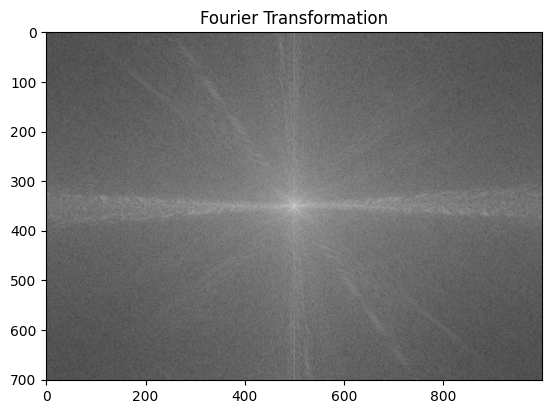

In [438]:
img_akropolis = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)

# Fourier Transformation
ft = np.fft.fft2(img_akropolis)
fshift = np.fft.fftshift(ft)


plt.imshow(np.log(abs(fshift)), cmap='gray')
plt.title('Fourier Transformation')

Text(0.5, 1.0, 'Bild ohne horizontale Linien')

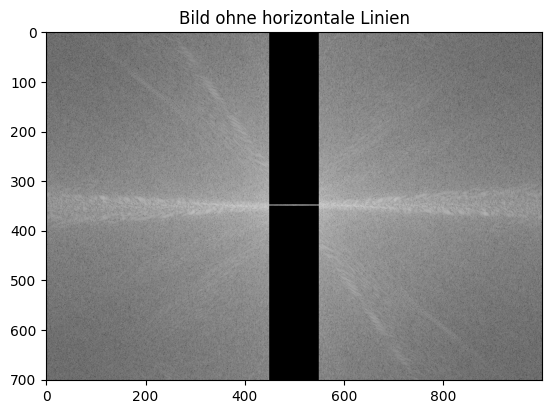

In [439]:
# Setze horizontale Linien auf 0


fshift[ : 349, 450:550] = 1
fshift[351 : , 450:550] = 1

plt.imshow(np.log(abs(fshift)), cmap='gray')
plt.title('Bild ohne horizontale Linien')


Text(0.5, 1.0, 'Bild ohne horizontale Linien')

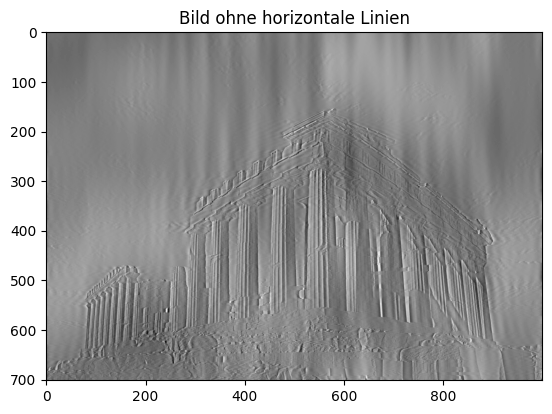

In [440]:
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = img_back.real

plt.imshow(img_back, cmap='gray')
plt.title('Bild ohne horizontale Linien')

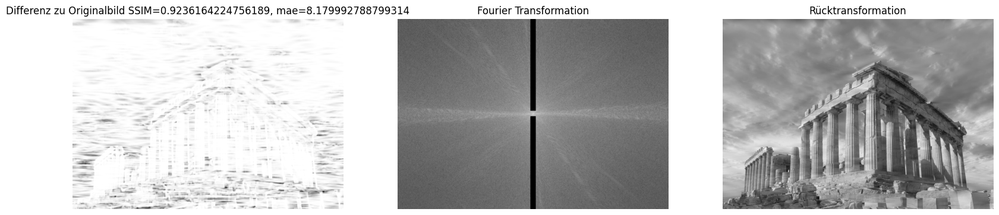

In [441]:
img_akropolis = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)
ft = np.fft.fft2(img_akropolis)
fshift = np.fft.fftshift(ft)

# Anpassung
fshift[ : 340, 490:510] = 1
fshift[360 : , 490:510] = 1
# Spektrum anzeigen
spektrum = np.log(abs(fshift))

# Rücktransformation
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = img_back.real

(ssim, diff) = skimage.metrics.structural_similarity(img_akropolis, img_back, data_range=255.0, full=True)

mae = np.mean(np.abs(img_akropolis - img_back))

dreiBilderFourier(diff, spektrum, img_back, ssim, mae)

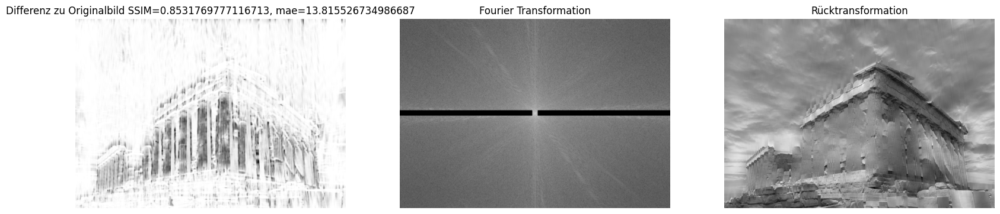

In [442]:
img_akropolis = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)
ft = np.fft.fft2(img_akropolis)
fshift = np.fft.fftshift(ft)

# Anpassung
fshift[ 340: 360, :490] = 1
fshift[340 : 360, 510:] = 1
# Spektrum anzeigen
spektrum = np.log(abs(fshift))

# Rücktransformation
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = img_back.real

(ssim, diff) = skimage.metrics.structural_similarity(img_akropolis, img_back, data_range=255.0, full=True)
mae = np.mean(np.abs(img_akropolis - img_back))

dreiBilderFourier(diff, spektrum, img_back, ssim, mae)

### Algorithmen zur Erkennung von Ecken in Bildern 

In [443]:
def convert_img_to_gray(img: np.ndarray) -> np.ndarray:
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


def calculate_gradient(img: np.ndarray) -> np.ndarray:
    return cv2.Sobel(img, cv2.CV_64F, 1, 1, ksize=5)

def calculate_gaussian_blur(img: np.ndarray, kernel_size: int) -> np.ndarray:
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    




Text(0.5, 1.0, 'gaussian_blur')

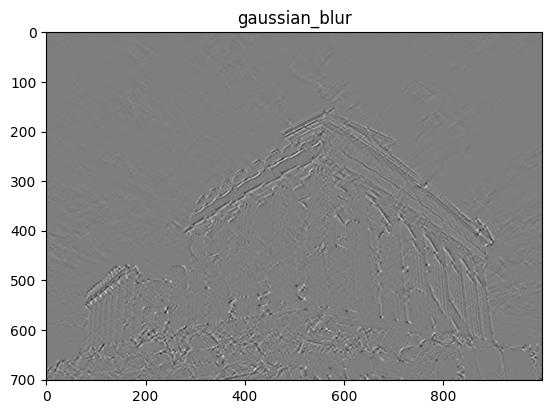

In [444]:
img = cv2.imread('Akropolis.jpg')

img_gray = convert_img_to_gray(img)
gradient = calculate_gradient(img_gray)
gaussian_blur = calculate_gaussian_blur(gradient, 5)

plt.imshow(gaussian_blur, cmap='gray')
plt.title('gaussian_blur')

Text(0.5, 1.0, 'Canny Edge Detection')

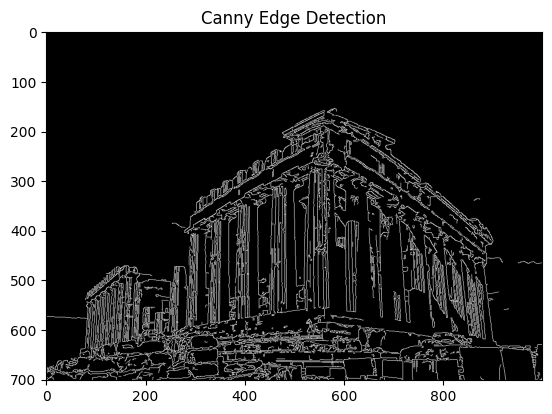

In [445]:
img_gray = cv2.cvtColor(cv2.imread('Akropolis.jpg'), cv2.COLOR_BGR2GRAY)

# Canny Edge Detection
edges = cv2.Canny(img_gray, 100, 200)

plt.imshow(edges, cmap='gray')
plt.title('Canny Edge Detection')

Text(0.5, 1.0, 'Harris Corner Detection')

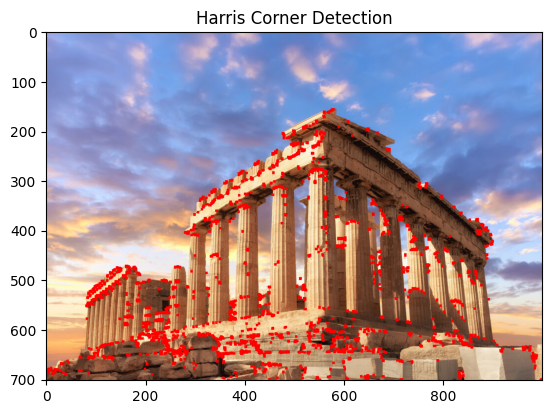

In [446]:
# Harris Corner Detection
img = cv2.imread('Akropolis.jpg')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Harris Corner Detection
dst = cv2.cornerHarris(img_gray, 2, 3, 0.04)

# Dilate
dst = cv2.dilate(dst, None, iterations=2)

# Threshold
img[dst > 0.01 * dst.max()] = [0, 0, 255]

plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Harris Corner Detection')


Text(0.5, 1.0, 'Combination of Canny Edge Detection and Harris Corner Detection')

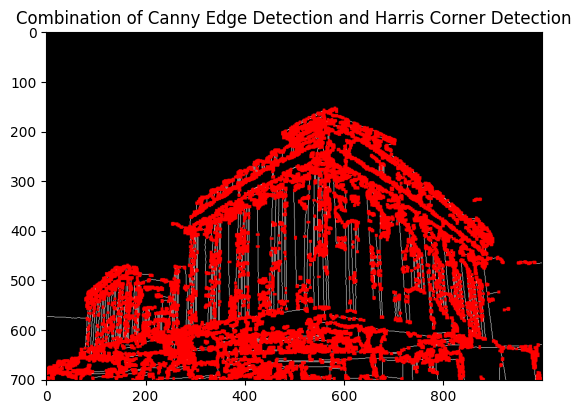

In [447]:
# Combination of Canny Edge Detection and Harris Corner Detection

img = cv2.imread('Akropolis.jpg')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Canny Edge Detection
edges = cv2.Canny(img_gray, 100, 200)

# Harris Corner Detection
dst = cv2.cornerHarris(edges, 2, 3, 0.04)

# Dilate
dst = cv2.dilate(dst, None, iterations=2)

edges = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
# Threshold
edges[dst > 0.01 * dst.max()] = [255, 0, 0]

plt.imshow(edges)
plt.title('Combination of Canny Edge Detection and Harris Corner Detection')
